In [1]:
import os
import re
from pydub import AudioSegment
import pandas as pd

dir = '/mnt/data/Speech Dataset/PunjabiSpeech/Punjabi Speech A labeled Speech Corpus'
clips = '/mnt/data/Speech Dataset/PunjabiSpeech/Punjabi Speech A labeled Speech Corpus/clips/'

train_tsv_file_path = '/mnt/data/Speech Dataset/PunjabiSpeech/Punjabi Speech A labeled Speech Corpus/train.tsv'
train_df = pd.read_csv(train_tsv_file_path, sep='\t', header=None)
print(train_df.shape)


(1942, 2)


In [2]:
train_df.head(2)

,0,1
0,1-M-2,ਵੋਮਨ ਹਾਕੀ ਦੀ ਗੋਲਡ ਮੈਡਲਲਿਸਟ ਸਮੀ ਜੋ ਸਮਾਲ ਉਬਾਮਾ ਨਾਲ
1,1-M-3,ਵੋਡਾਫੋਨ ਅਤੇ ਹਚੀਸਨ ਮਾਮਲੇ ਵਿਚ ਕਾਫੀ ਵਿਵਾਦ ਚਲਦਾ ਰਿਹਾ


In [3]:
# change 0 to file_name and 1 to text
train_df.columns = ['file_name', 'text']
# extract gender from file_name
# if it's M then male, F then female otherwise unknown
def get_gender(file_name):
    if 'M' in file_name:
        return 'm'
    elif 'F' in file_name:
        return 'f'
    else:
        return 'o'
    
train_df['speaker_id'] = train_df['file_name'].apply(lambda x: x.split('-')[0])
train_df['gender'] = train_df['file_name'].apply(get_gender)
# add .wav to file_name
train_df['file_name'] = train_df['file_name'].apply(lambda x: x.strip() + '.wav')

train_df.head(2)

,file_name,text,speaker_id,gender
0,1-M-2.wav,ਵੋਮਨ ਹਾਕੀ ਦੀ ਗੋਲਡ ਮੈਡਲਲਿਸਟ ਸਮੀ ਜੋ ਸਮਾਲ ਉਬਾਮਾ ਨਾਲ,1,m
1,1-M-3.wav,ਵੋਡਾਫੋਨ ਅਤੇ ਹਚੀਸਨ ਮਾਮਲੇ ਵਿਚ ਕਾਫੀ ਵਿਵਾਦ ਚਲਦਾ ਰਿਹਾ,1,m


Text(0.5, 1.0, 'Audio length distribution in seconds')

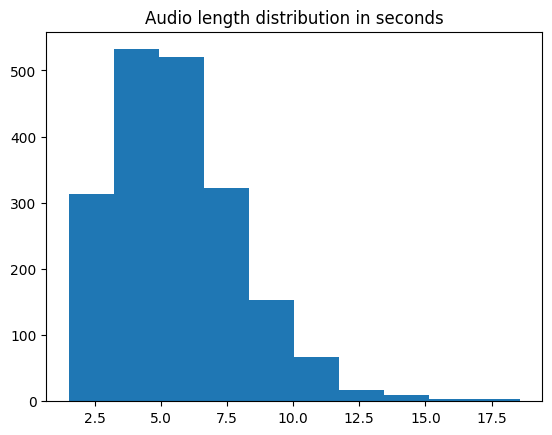

In [4]:
import pylab as plt

def get_audio_duration(file_path):
    audio = AudioSegment.from_file(f'{clips}{file_path}')
    return audio.duration_seconds

train_df['duration'] = train_df['file_name'].apply(get_audio_duration)
plt.hist(train_df['duration'])
plt.title('Audio length distribution in seconds')

In [6]:
train_df.columns

Index(['file_name', 'text', 'speaker_id', 'gender', 'duration'], dtype='object')

In [7]:
train_df.iloc[10]['file_name']

'1-M-14.wav'

In [8]:
next(iter(train_df.iterrows()))[1]['text']

'ਵੋਮਨ ਹਾਕੀ ਦੀ ਗੋਲਡ ਮੈਡਲਲਿਸਟ ਸਮੀ ਜੋ ਸਮਾਲ ਉਬਾਮਾ ਨਾਲ'

In [9]:
import random

# for balanced duration dataset
def random_cutter(dur):
    if random.random() < 0.15:
        return dur > 30 * (random.random()*0.95+0.05)
    else:
        return dur > 30

expanded_clips_path = clips.replace('/clips', '/expanded_clips')

# Adapted chunk_merger for use with DataFrame and duration
def chunk_merger(df, speaker_id, should_cut=lambda x: x > 30):
    speaker_segments = df[df['speaker_id'] == speaker_id] 
    if speaker_segments.empty: return []

    result = []

    expanding_row = None
    expanding_audio = None

    for index, row in speaker_segments.iterrows():
        audio = AudioSegment.from_file(f'{clips}{row["file_name"]}')
        row['text'] = row['text'].strip()

        if expanding_row is None:
            expanding_row = row
            expanding_audio = audio
        elif should_cut(expanding_row['duration'] + row['duration']):
            output_file_path = f'{expanded_clips_path}/{expanding_row["file_name"]}'
            expanding_audio.export(output_file_path, format='wav')
            expanding_row['duration'] = expanding_audio.duration_seconds
            expanding_row['audio'] = output_file_path
            result.append(expanding_row)
            expanding_row = row
            expanding_audio = audio
        else:
            expanding_row['duration'] += row['duration']
            expanding_row['text'] += ' ' + row['text']
            expanding_audio += audio
    if expanding_row is not None and expanding_audio is not None:
        output_file_path = f'{expanded_clips_path}/{expanding_row["file_name"]}'
        expanding_audio.export(output_file_path, format='wav')
        expanding_row['duration'] = expanding_audio.duration_seconds
        expanding_row['audio'] = output_file_path
        result.append(expanding_row)

    return result

# create expanded_clips directory if it doesn't exist
os.makedirs(expanded_clips_path, exist_ok=True)
all_merged_segments = []  # This will store DataFrames for all speakers

for speaker_id in train_df['speaker_id'].unique():
    merged_segments = chunk_merger(train_df, speaker_id, should_cut=random_cutter)
    # Convert list of Series to DataFrame and collect
    if merged_segments:  # Ensure the list is not empty
        merged_segments_df = pd.DataFrame(merged_segments)
        all_merged_segments.append(merged_segments_df)


result_df = pd.concat(all_merged_segments, ignore_index=True)


In [10]:
result_df.head(3)

,file_name,text,speaker_id,gender,duration,audio
0,1-M-2.wav,ਵੋਮਨ ਹਾਕੀ ਦੀ ਗੋਲਡ ਮੈਡਲਲਿਸਟ ਸਮੀ ਜੋ ਸਮਾਲ ਉਬਾਮਾ ਨ...,1,m,21.85,/mnt/data/Speech Dataset/PunjabiSpeech/Punjabi...
1,1-M-5.wav,ਵੋਟਿੰਗ ਕੇਂਦਰਾਂ ਤੇ ਲੋਕਾਂ ਦੀਆਂ ਵੋਟਾਂ ਵਿੱਚ ਜਿੱਤ ਕ...,1,m,21.14,/mnt/data/Speech Dataset/PunjabiSpeech/Punjabi...
2,1-M-8.wav,ਵੋਟਾਂ ਲਈ ਹਜ਼ਾਰ ਵੋਟਿੰਗ ਕੇਂਦਰ ਸਥਾਪਿਤ ਕੀਤੇ ਜਾਣਗੇ...,1,m,19.75,/mnt/data/Speech Dataset/PunjabiSpeech/Punjabi...


Text(0.5, 1.0, 'Audio length distribution in seconds')

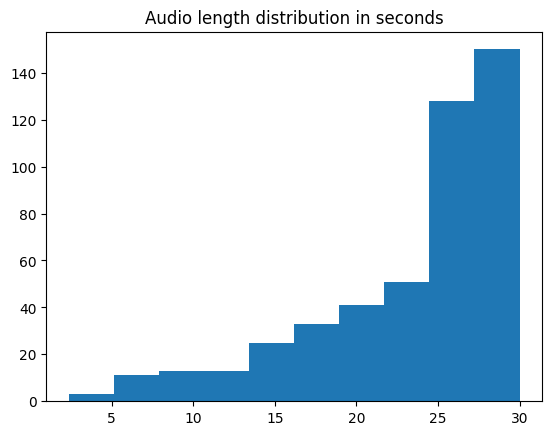

In [11]:

plt.hist(result_df['duration'])
plt.title('Audio length distribution in seconds')

In [12]:
valid_tsv_file_path = '/mnt/data/Speech Dataset/PunjabiSpeech/Punjabi Speech A labeled Speech Corpus/dev.tsv'
valid_df = pd.read_csv(valid_tsv_file_path, sep='\t', header=None)

test_tsv_file_path = '/mnt/data/Speech Dataset/PunjabiSpeech/Punjabi Speech A labeled Speech Corpus/test.tsv'
test_df = pd.read_csv(test_tsv_file_path, sep='\t', header=None)

valid_df.head(2)

,0,1
0,1-M-13,ਵੋਟਾਂ ਦੀ ਗਿਣਤੀ ਵਾਸਤੇ ਕਾਂਊਟਿੰਗ ਸਟਾਫ ਤਾਇਨਾਤ
1,1-M-17,ਵੋਟਾਂ ਜਿਸ ਨੂੰ ਪਾੳ ਪਰ ਦੇਖੋ ਕਿਹੜਾ ਤੁਹਾਡਾ ਕੰਮ ਕਰਦ...


In [13]:
valid_df.shape, test_df.shape

((243, 2), (243, 2))

In [14]:
# change 0 to file_name and 1 to text
valid_df.columns = ['file_name', 'text']

valid_df['speaker_id'] = valid_df['file_name'].apply(lambda x: x.split('-')[0])
valid_df['gender'] = valid_df['file_name'].apply(get_gender)
valid_df['file_name'] = valid_df['file_name'].apply(lambda x: x.strip() + '.wav')

valid_df['duration'] = valid_df['file_name'].apply(get_audio_duration)

test_df.columns = ['file_name', 'text']
test_df['speaker_id'] = test_df['file_name'].apply(lambda x: x.split('-')[0])
test_df['gender'] = test_df['file_name'].apply(get_gender)
test_df['file_name'] = test_df['file_name'].apply(lambda x: x.strip() + '.wav')
test_df['duration'] = test_df['file_name'].apply(get_audio_duration)

test_df.head(2)

,file_name,text,speaker_id,gender,duration
0,1-M-10.wav,ਵੋਟਾਂ ਧਰਮ ਅਤੇ ਜਾਤਿ ਦੇ ਨਾਂ ਤੇ ਪੱਕੀਆਂ ਕੀਤੀਆਂ ਜਾਂ...,1,m,7.16
1,1-M-42.wav,ਵੋਟ ਕੌਣ ਪਾ ਸਕਦਾ ਹੈ,1,m,4.12


In [15]:
result_df.head(3)

,file_name,text,speaker_id,gender,duration,audio
0,1-M-2.wav,ਵੋਮਨ ਹਾਕੀ ਦੀ ਗੋਲਡ ਮੈਡਲਲਿਸਟ ਸਮੀ ਜੋ ਸਮਾਲ ਉਬਾਮਾ ਨ...,1,m,21.85,/mnt/data/Speech Dataset/PunjabiSpeech/Punjabi...
1,1-M-5.wav,ਵੋਟਿੰਗ ਕੇਂਦਰਾਂ ਤੇ ਲੋਕਾਂ ਦੀਆਂ ਵੋਟਾਂ ਵਿੱਚ ਜਿੱਤ ਕ...,1,m,21.14,/mnt/data/Speech Dataset/PunjabiSpeech/Punjabi...
2,1-M-8.wav,ਵੋਟਾਂ ਲਈ ਹਜ਼ਾਰ ਵੋਟਿੰਗ ਕੇਂਦਰ ਸਥਾਪਿਤ ਕੀਤੇ ਜਾਣਗੇ...,1,m,19.75,/mnt/data/Speech Dataset/PunjabiSpeech/Punjabi...


In [16]:
# convert to datasets and save
from datasets import Dataset, DatasetDict

train_dataset = Dataset.from_pandas(result_df)
valid_dataset = Dataset.from_pandas(valid_df)
test_dataset = Dataset.from_pandas(test_df)



In [17]:
train_dataset[0]

{'file_name': '1-M-2.wav',
 'text': 'ਵੋਮਨ ਹਾਕੀ ਦੀ ਗੋਲਡ ਮੈਡਲਲਿਸਟ ਸਮੀ ਜੋ ਸਮਾਲ ਉਬਾਮਾ ਨਾਲ ਵੋਡਾਫੋਨ ਅਤੇ ਹਚੀਸਨ ਮਾਮਲੇ ਵਿਚ ਕਾਫੀ ਵਿਵਾਦ ਚਲਦਾ ਰਿਹਾ ਵੋਟਿੰਗ ਮਗਰੋਂ ਚੋਣ ਨਤੀਜਿਆਂ ਨੂੰ ਲੈ ਕੇ ਸਾਰਿਆਂ ਨੂੰ ਧੁਕਧੁਕੀ ਲੱਗੀ ਹੋਈ ਹੈ',
 'speaker_id': '1',
 'gender': 'm',
 'duration': 21.85,
 'audio': '/mnt/data/Speech Dataset/PunjabiSpeech/Punjabi Speech A labeled Speech Corpus/expanded_clips//1-M-2.wav'}

In [18]:
# update file name to full path
train_dataset = train_dataset.map(lambda x: {'file_name': f'{expanded_clips_path}/{x["file_name"]}'})
valid_dataset = valid_dataset.map(lambda x: {'file_name': f'{clips}/{x["file_name"]}'})
test_dataset = test_dataset.map(lambda x: {'file_name': f'{clips}/{x["file_name"]}'})

Map:   0%|          | 0/468 [00:00<?, ? examples/s]

Map:   0%|          | 0/243 [00:00<?, ? examples/s]

Map:   0%|          | 0/243 [00:00<?, ? examples/s]

In [19]:
train_dataset

Dataset({
    features: ['file_name', 'text', 'speaker_id', 'gender', 'duration', 'audio'],
    num_rows: 468
})

In [20]:
from datasets import Audio

train_dataset = train_dataset.cast_column('file_name', Audio(sampling_rate = 16000))
valid_dataset = valid_dataset.cast_column('file_name', Audio(sampling_rate = 16000))
test_dataset = test_dataset.cast_column('file_name', Audio(sampling_rate = 16000))

train_dataset

Dataset({
    features: ['file_name', 'text', 'speaker_id', 'gender', 'duration', 'audio'],
    num_rows: 468
})

In [21]:
train_dataset[0]

{'file_name': {'path': '/mnt/data/Speech Dataset/PunjabiSpeech/Punjabi Speech A labeled Speech Corpus/expanded_clips//1-M-2.wav',
  'array': array([ 7.37223309e-04,  1.33055879e-03,  1.13119022e-03, ...,
          1.45877944e-04, -2.39251458e-05,  3.16761580e-05]),
  'sampling_rate': 16000},
 'text': 'ਵੋਮਨ ਹਾਕੀ ਦੀ ਗੋਲਡ ਮੈਡਲਲਿਸਟ ਸਮੀ ਜੋ ਸਮਾਲ ਉਬਾਮਾ ਨਾਲ ਵੋਡਾਫੋਨ ਅਤੇ ਹਚੀਸਨ ਮਾਮਲੇ ਵਿਚ ਕਾਫੀ ਵਿਵਾਦ ਚਲਦਾ ਰਿਹਾ ਵੋਟਿੰਗ ਮਗਰੋਂ ਚੋਣ ਨਤੀਜਿਆਂ ਨੂੰ ਲੈ ਕੇ ਸਾਰਿਆਂ ਨੂੰ ਧੁਕਧੁਕੀ ਲੱਗੀ ਹੋਈ ਹੈ',
 'speaker_id': '1',
 'gender': 'm',
 'duration': 21.85,
 'audio': '/mnt/data/Speech Dataset/PunjabiSpeech/Punjabi Speech A labeled Speech Corpus/expanded_clips//1-M-2.wav'}

In [25]:
train_dataset, valid_dataset, test_dataset

(Dataset({
     features: ['file_name', 'text', 'speaker_id', 'gender', 'duration', 'audio'],
     num_rows: 468
 }),
 Dataset({
     features: ['file_name', 'text', 'speaker_id', 'gender', 'duration'],
     num_rows: 243
 }),
 Dataset({
     features: ['file_name', 'text', 'speaker_id', 'gender', 'duration'],
     num_rows: 243
 }))

In [26]:
# remove audio from train dataset
train_dataset = train_dataset.remove_columns('audio')

In [27]:
# rename column to audio
train_dataset = train_dataset.rename_column('file_name', 'audio')
valid_dataset = valid_dataset.rename_column('file_name', 'audio')
test_dataset = test_dataset.rename_column('file_name', 'audio')


In [28]:
train_dataset[0]

{'audio': {'path': '/mnt/data/Speech Dataset/PunjabiSpeech/Punjabi Speech A labeled Speech Corpus/expanded_clips//1-M-2.wav',
  'array': array([ 7.37223309e-04,  1.33055879e-03,  1.13119022e-03, ...,
          1.45877944e-04, -2.39251458e-05,  3.16761580e-05]),
  'sampling_rate': 16000},
 'text': 'ਵੋਮਨ ਹਾਕੀ ਦੀ ਗੋਲਡ ਮੈਡਲਲਿਸਟ ਸਮੀ ਜੋ ਸਮਾਲ ਉਬਾਮਾ ਨਾਲ ਵੋਡਾਫੋਨ ਅਤੇ ਹਚੀਸਨ ਮਾਮਲੇ ਵਿਚ ਕਾਫੀ ਵਿਵਾਦ ਚਲਦਾ ਰਿਹਾ ਵੋਟਿੰਗ ਮਗਰੋਂ ਚੋਣ ਨਤੀਜਿਆਂ ਨੂੰ ਲੈ ਕੇ ਸਾਰਿਆਂ ਨੂੰ ਧੁਕਧੁਕੀ ਲੱਗੀ ਹੋਈ ਹੈ',
 'speaker_id': '1',
 'gender': 'm',
 'duration': 21.85}

In [29]:
train_dataset, valid_dataset, test_dataset

(Dataset({
     features: ['audio', 'text', 'speaker_id', 'gender', 'duration'],
     num_rows: 468
 }),
 Dataset({
     features: ['audio', 'text', 'speaker_id', 'gender', 'duration'],
     num_rows: 243
 }),
 Dataset({
     features: ['audio', 'text', 'speaker_id', 'gender', 'duration'],
     num_rows: 243
 }))

In [30]:
ds = DatasetDict({'train': train_dataset, 'valid': valid_dataset, 'test': test_dataset})

ds.save_to_disk('/mnt/data/Speech Dataset/processed_datasets/PunjabiSpeech_A_labeled_Speech_Corpus_ASR')

Saving the dataset (0/3 shards):   0%|          | 0/468 [00:00<?, ? examples/s]

Saving the dataset (0/1 shards):   0%|          | 0/243 [00:00<?, ? examples/s]

Saving the dataset (0/1 shards):   0%|          | 0/243 [00:00<?, ? examples/s]

In [31]:
from datasets import load_from_disk

ds = load_from_disk('/mnt/data/Speech Dataset/processed_datasets/PunjabiSpeech_A_labeled_Speech_Corpus_ASR')
ds

DatasetDict({
    train: Dataset({
        features: ['audio', 'text', 'speaker_id', 'gender', 'duration'],
        num_rows: 468
    })
    valid: Dataset({
        features: ['audio', 'text', 'speaker_id', 'gender', 'duration'],
        num_rows: 243
    })
    test: Dataset({
        features: ['audio', 'text', 'speaker_id', 'gender', 'duration'],
        num_rows: 243
    })
})

In [33]:
import IPython.display as ipd
from IPython.display import Audio

durations = ds['train']['duration']
# get indexes of 20 longest audio files
indexes = sorted(range(len(durations)), key=lambda x: durations[x], reverse=True)[:20]
text = ds['train']['text']
indexes = sorted(range(len(text)), key=lambda x: len(text[x]), reverse=True)[:20]
print(indexes)
ds_check = ds['train'].select(indexes)

def display_audio(row):
    print(row['text'])
    return Audio(row['audio']['array'], rate=16000, autoplay=True)
# sort by length of text
for i in range(20):
    r = display_audio(ds_check[i])
    ipd.display(r)

[445, 222, 402, 317, 401, 372, 269, 462, 173, 265, 249, 406, 443, 420, 431, 373, 364, 391, 394, 410]
ਗੁਰੂ ਗ੍ਰੰਥ ਸਾਹਿਬ ਨੂੰ ਸਿੱਖ ਧਰਮ ਦੇ ਸਰਬੋਤਮ ਅਧਿਕਾਰ ਵਜੋਂ ਪੂਜਿਆ ਜਾਂਦਾ ਹੈ ਅਤੇ ਸਿੱਖ ਧਰਮ ਦੇ ਗਿਆਰ੍ਹਵੇਂ ਅਤੇ ਆਖ਼ਰੀ ਗੁਰੂ ਵਜੋਂ ਜਾਣਿਆ ਜਾਂਦਾ ਹੈ ਸਿੱਖ ਧਰਮ ਦੇ ਪਹਿਲੇ ਗੁਰੂ ਹੋਣ ਦੇ ਨਾਤੇ ਗੁਰੂ ਨਾਨਕ ਦੇਵ ਜੀ ਨੇ ਗੁਰੂ ਗ੍ਰੰਥ ਸਾਹਿਬ ਵਿੱਚ ਕੁਲ ਨੌਂ ਸੌ ਚੁਹੱਤਰ ਭਜਨਾਂ ਦਾ ਯੋਗਦਾਨ ਪਾਇਆ ਹੈ ਗੁਰੂ ਨਾਨਕ ਦੇਵ ਜੀ ਦੀ ਸਿਖਿਆ ਗੁਰੂ ਗ੍ਰੰਥ ਸਾਹਿਬ ਵਿਚੋਂ ਮਿਲ ਸਕਦੀ ਹੈ ਜਿਵੇਂ ਗੁਰਮੁਖੀ ਵਿਚ ਦਰਜ ਬਾਣੀ ਦਾ ਸੰਗ੍ਰਹਿ


ਪੌਣੇ ਤਿੰਨ ਵਜੇ ਇਰਾਨ ਤੇ ਇਟਲੀ ਦੀਆਂ ਟੀਮਾਂ ਗਾਊਨ ਪਾਈ ਮੈਦਾਨ ਵਿਚ ਆਈਆਂ ਪੈਰ ਪੈਰ ਦੇ ਰਾਹੇ ਰਾਹੇ ਪੇਟੀਆਂ ਤੇ ਅਲਮਾਰੀਆਂ ਦੇ ਜਿੰਦੇ ਤੋੜੇ ਪਏ ਸਨ ਪੂਰਨਮਾਸ਼ੀ ਦੀਆਂ ਰਾਤਾਂ ਨੂੰ ਕੁਝ ਲੈਕਚਰਰ ਸਪਾਟਾ ਕਰਨ ਨਿਕਲ ਤੁਰਦੇ ਸੀ ਪੁਲਿਸ ਨੇ ਸਖਤ ਸੁਰੱਖਿਆ ਪ੍ਰਬੰਧ ਕੀਤੇ ਹੋਏ ਸਨ ਪੁਲਿਸ ਨੂੰ ਕਿਸੇ ਨੇ ਵਿਚੋਂ ਹੀ ਕਿਹਾ ਇਹ ਕੁੜੀ ਮੁੰਡੇ ਦਾ ਚੱਕਰ ਚਲਦਾ ਸੀ ਪੁਲਿਸ ਨੇ ਲਾਸ਼ ਪੋਸਟਮਾਰਟਮ ਲਈ ਭੇਜ ਦਿੱਤੀ ਹੈ


ਉਨ੍ਹਾਂ ਦੇ ਮਨ ਚ ਹਰ ਸਮੇਂ ਕੰਮ ਹੀ ਛਾਇਆ ਰਹਿੰਦਾ ਹੈ ਉਨ੍ਹਾਂ ਦੇ ਚਿਹਰੇ ਤੇ ਕੋਈ ਇਲਾਹੀ ਨੂਰ ਡੁੱਲ ਡੁੱਲ ਪੈਂਦਾ ਸੀ ਉਨ੍ਹਾਂ ਦੇ ਘਰੋਂ ਜੋ ਦਸਤਾਵੇਜ਼ ਮਿਲੇ ਉਨ੍ਹਾਂ ਤੋਂ ਉਨ੍ਹਾਂ ਦੇ ਕੋਲ ਬੈਠੇ ਸੀਸੀ ਪਾਟਿਲ ਵੀ ਮੋਬਾਇਲ ਤੇ ਨਜ਼ਰਾਂ ਟਿਕਾਈ ਬੈਠੇ ਹਨ ਉਨ੍ਹਾਂ ਦੇ ਸਾਰੇ ਪੁਰਾਣੇ ਨਜ਼ਦੀਕੀਆਂ ਨੇ ਉਨ੍ਹਾਂ ਨੂੰ ਧੋਖਾ ਦੇ ਦਿੱਤਾ ਉਨ੍ਹਾਂ ਦੀ ਖੁਸ਼ੀ ਦਾ ਕੋਈ ਟਿਕਾਣਾ ਨਾ ਰਿਹਾ ਉਨ੍ਹਾਂ ਦੀ ਕਪਤਾਨੀ ਚ


ਹਵਸ ਦੇ ਨਾਗਾਂ ਨੇ ਡੱਸ ਸਥਿਤੀ ਸੀ ਤਾਂ ਵਰਗੀ ਭੈਣ ਕਿਸੇ ਦੀ ਹਲਵਾਈ ਕਦੇ ਸਬਜ਼ੀਆਂ ਨੂੰ ਮਿਚਕੇ ਨਹੀਂ ਬਣਾਉਂਦੇ ਹਰੇਕ ਚੀਜ਼ ਨੂੰ ਕਿਸੇ ਮੰਜ਼ਿਲ ਤੇ ਪਹੁੰਚਣ ਲਈ ਕੁਝ ਸਮਾਂ ਚਾਹੀਦਾ ਹੈ ਹਰਮਨ ਕੌਰ ਤੋਂ ਸਾਲ ਦੇ ਵਰਗ ਵਿਚ ਭਾਗ ਲੈਂਦੀ ਹੈ ਹਰਪ੍ਰੀਤ ਕੌਰ ਦੇ ਅਪ੍ਰੈਲ ਵਿਚ ਸ਼ੱਕੀ ਹਾਲਤ ਵਿਚ ਮੌਤ ਹੋ ਗਈ ਸੀ ਹਰਜੀਤ ਕਦੇ ਕਦੇ ਮੈਨੂੰ ਮਿਲਣ ਲਈ ਢੁੱਡੀਕੇ ਵੀ ਆ ਜਾਂਦਾ ਸੀ ਹਰ ਵਿਅਕਤੀ ਦਾ ਆਪਣਾ ਆਪਣਾ ਰੋਲ


ਉਨ੍ਹਾਂ ਨੂੰ ਵਿਦੇਸ਼ ਜਾਣ ਅਤੇ ਪੌਂਡ ਤੇ ਡਾਲਰ ਭੋਟਣ ਦਾ ਲਾਲਚ ਖਿੱਚੀ ਜਾ ਰਿਹੈ ਉਨ੍ਹਾਂ ਨੂੰ ਮੁਫਤ ਕਬੱਡੀ ਨਾਲ ਖਾਣ ਪੀਣ ਨੂੰ ਵੀ ਮੁਫ਼ਤ ਮਿਲਦਾ ਰਿਹਾ ਉਨ੍ਹਾਂ ਨੂੰ ਧੀ ਦਾ ਕੋਈ ਥੋਹਪਤਾ ਨਹੀਂ ਲੱਗਦਾ ਉਨ੍ਹਾਂ ਨੂੰ ਤਾਂ ਸਿਰਫ ਖਾਣ ਲਈ ਰੋਟੀ ਅਤੇ ਪੀਣ ਲਈ ਪਾਣੀ ਹੀ ਚਾਹੀਦਾ ਹੈ ਉਨ੍ਹਾਂ ਨੂੰ ਇਲਾਜ ਦੇ ਲਈ ਸਿਵਲ ਹਸਪਤਾਲ ਲੈ ਜਾਇਆ ਗਿਆ ਉਨ੍ਹਾਂ ਨਾਲ ਜੋ ਵਾਪਰਿਆ ਹੈ ਸਿੱਖ ਕੌਮ ਲਈ ਬਹੁਤ ਘਾਤਕ ਹੈ


ਇਸ ਕਰਕੇ ਉਨ੍ਹਾਂ ਨੂੰ ਨਿੱਜੀ ਪੇਸ਼ੀ ਤੋਂ ਸ਼ੂਟ ਦਿੱਤੀ ਜਾਵੇ ਇਸ ਹਾਕੀ ਗਰਾਊਂਡ ਨੂੰ ਅਮਰੀਕਾ ਦੀ ਨਾਮਵਰ ਸਿਨਕੋਨ ਕੰਪਨੀ ਬਣਾ ਰਹੀ ਹੈ ਇਸ ਹਮਲੇ ਦੌਰਾਨ ਭੰਨਿਆ ਰਾਮ ਵਾਲੇ ਦੇ ਕੰਨ ਅਤੇ ਨੱਕ ਤੇ ਸੱਟਾਂ ਲੱਗ ਗਈਆਂ ਇਸ ਹੱਤਿਆ ਕਾਂਡ ਵਿਚ ਸ਼ਾਮਲ ਚਾਰ ਅਣਪਛਾਤੇ ਵਿਅਕਤੀਆਂ ਦੀ ਸ਼ਨਾਖਤ ਵੀ ਹੋ ਗਈ ਹੈ ਇਸ ਸੂਰਜ ਦੀਆਂ ਕਿਰਨਾਂ ਦੀ ਇਸ ਸ਼ਾਹੀ ਜੋੜੀ ਦਾ ਵਿਆਹ ਇਸੇ ਸਾਲ ਜੁਲਾਈ ਮਹੀਨੇ ਵਿੱਚ ਹੋਇਆ ਹੈ


ਜਿੱਥੇ ਸਮਾਜਿਕ ਸਭਾਂਵਾਂ ਹੁੰਦੀਆਂ ਹੋਣ ਉੱਥੇ ਮੈਂ ਘੱਟ ਹੀ ਜਾਂਦਾ ਹਾਂ ਜਿਥੇ ਉਨ੍ਹਾਂ ਨੇ ਰਾਤ ਕੱਟੀ ਉਹ ਜਗ੍ਹਾ ਪਿੰਡ ਦੇ ਕਿਲੇ ਤੋਂ ਵਾਹਵਾ ਹਟਵੀਂ ਸੀ ਜਿਹੜਾ ਉਨ੍ਹਾਂ ਕੋਲ ਗਿਆ ਉਹ ਕੁਝ ਲੈ ਕੇ ਹੀ ਪਰਤਿਆ ਜਿਸ ਨੂੰ ਲੈ ਕੇ ਸਥਾਨਕ ਬਾਸ਼ਿੰਦਿਆਂ ਨੇ ਅਦਾਲਤ ਦੇ ਬਾਹਰ ਜੋਰਦਾਰ ਪ੍ਰਦਰਸ਼ਨ ਕੀਤਾ ਜਿਸ ਦੀ ਕੋਈ ਆਸ ਹੀ ਨਹੀਂ ਉਸਨੂੰ ਤੁਸੀਂ ਨਿਰਾਸ਼ ਕਿਵੇਂ ਕਰੋਗੇ ਉਸਦੀ ਪ੍ਰਫੁਲਤਾ ਅਣਛੂਤੀ ਰਹੇਗੀ


ਐਮਨਾਬਾਦ ਬਾਬਰ ਦਾ ਹਮਲਾ ਹੋਇਆ ਜਿਸ ਦਾ ਵਰਣਨ ਆਪ ਜੀ ਨੇ ਆਪਣੀ ਬਾਣੀ ਵਿੱਚ ਕੀਤਾ ਗੁਰੂ ਨਾਨਕ ਸਾਹਿਬ ਆਪਣੀ ਤੀਜੀ ਉਦਾਸੀ ਦੌਰਾਨ ਮੱਕੇ ਗਏ ਸਨ ਮੱਕੇ ਜਾਣ ਵਾਲੇ ਦੌਰੇ ਵਿਚ ਉਹ ਮੁਲਤਾਨ ਵਲੋਂ ਹੋ ਕੇ ਗਏ ਸਨ ਮੁਲਤਾਨ ਤੋਂ ਚਲ ਕੇ ਗੁਰੂ ਸਾਹਿਬ ਉੱਚ ਨਗਰ ਜਿਸ ਨੂੰ ਮੁਸਲਮਾਨਾਂ ਪੀਰਾਂ ਫ਼ਕੀਰਾਂ ਦਾ ਸ਼ਹਿਰ ਮੰਨਿਆ ਜਾਂਦਾ ਸੀ ਇਸ ਨਗਰ ਵਿਚ ਸੱਯਦ ਜਲਾਲ ਬੁਖ਼ਾਰੀ ਦੀ ਗੱਦੀ ਦੀ ਬੜੀ ਮਾਨਤਾ ਸੀ


ਵੱਖਰੇ ਤੇ ਲਿੰਗ ਨਾ ਸੂਬੇ ਨੂੰ ਲੈ ਕੇ ਆਂਧਰਾ ਪ੍ਰਦੇਸ਼ ਦੀ ਰਾਜਨੀਤੀ ਪੱਖ ਗਈ ਹੈ ਲੋੜ ਪੈਣ ਤੇ ਪੈਸੇ ਕਢਾ ਸਕਦਾ ਹੈ ਦੀਪਕ ਨੇ ਕਿਹਾ ਤੁਸੀਂ ਧੋਖਾ ਕੀਤਾ ਹੈ ਲੋਕਾਂ ਨੇ ਦੋਸ਼ੀ ਨੂੰ ਮੌਕੇ ਤੇ ਹੀ ਕਾਬੂ ਕਰ ਕੇ ਪੁਲਿਸ ਹਵਾਲੇ ਕਰ ਦਿੱਤਾ ਲੋਕਾਂ ਦੇ ਜਾਨ ਮਾਲ ਦਾ ਨੁਕਸਾਨ ਹੀ ਹੋਵੇਗਾ ਲੋਕਾਂ ਦੇ ਇਲਾਜ ਲਈ ਸਰਕਾਰੀ ਇਲਾਜਤੰਤਰ ਬੁਰੀ ਤਰ੍ਹਾਂ ਫੇਲ੍ਹ ਹੋ ਚੁੱਕਾ ਹੈ ਲੋਕ ਰੱਬ ਨੂੰ ਮੰਨਦੇ ਹਨ


ਜੇਲ੍ਹਾਂ ਵਿੱਚ ਬੰਦੀਆਂ ਨੂੰ ਦਿਨ ਵਿਚ ਦੋ ਵਾਰ ਚਾਹ ਦਿੱਤੀ ਜਾਂਦੀ ਹੈ ਜੇਕਰ ਬੋਟਿੰਗ ਦਾ ਪ੍ਰਬੰਧ ਹੋਵੇ ਤਾਂ ਉਸ ਦਾ ਮਜ਼ਾ ਲੈਣਾ ਨਾ ਭੁੱਲੋ ਜੇਕਰ ਸਾੜੀ ਪਹਿਨਣ ਵਿਚ ਤੁਸੀਂ ਪਰਫੈਕਟ ਨਹੀਂ ਹੋ ਤਾਂ ਸਾੜੀ ਨਾ ਪਹਿਨੋ ਜੇਕਰ ਇਸ ਦੌਰਾਨ ਚੋਣਾਂ ਆ ਜਾਣ ਤਾਂ ਇਹ ਮੁਲਾਕਾਤ ਵੀ ਨਹੀਂ ਹੋ ਸਕਦੀ ਜੇ ਪੰਜਾਬੀ ਗੱਭਰੂ ਮੁਟਿਆਰਾਂ ਅਣਖੀਲੇ ਕਹਾਉਂਦੇ ਨੇ ਤਾਂ ਸ਼ਰਮਹਯਾ ਵੀ ਇਨ੍ਹਾਂ ਦਾ ਗਹਿਣਾ ਹੈ


ਦੂਜਾ ਹੈ ਹਰ ਪੱਖ ਤੋਂ ਕੀਤਾ ਗਿਆ ਵਿਕਾਸ ਦੁਨੀਆ ਵਿਚ ਆਪਣੀ ਕਿਸਮ ਦੀ ਇਹ ਪਹਿਲੀ ਉਦਾਹਰਣ ਹੈ ਦੁਨੀਆਂ ਦੀ ਹਰ ਖ਼ਬਰ ਦੀ ਜਾਣਕਾਰੀ ਹੋਵੇ ਦੁਨੀਆ ਖ਼ਾਸ ਤੌਰ ਤੇ ਨੌਜਵਾਨ ਤਬਕਾ ਬੇਰੁਜ਼ਗਾਰ ਹੋ ਕੇ ਮੱਖੀਆਂ ਮਾਰਨ ਲੱਗ ਪਿਆ ਦੁੱਧ ਝੰਗਾਉਣ ਤੋਂ ਪਹਿਲਾਂ ਆਪਣੀਆਂ ਛਾਤੀਆਂ ਚੰਗੇ ਤਰ੍ਹਾਂ ਸਾਫ ਕਰ ਲਓ ਦੁਕਾਨਦਾਰ ਜੀ ਰੁਪੈ ਦੀਵਾ ਲਈ ਦੀਵਿਆਂ ਵਾਲੀ ਅਰਥਾਤ ਦੀ ਪਾਵਲੀ ਸ਼ਬਦਾਂ ਦਾ ਸੁਮੇਲ ਹੈ


ਉਦੋਂ ਭੂਤਾਂ ਪ੍ਰੇਤਾਂ ਦੀਆਂ ਗੱਲਾਂ ਆਮ ਹੁੰਦੀਆਂ ਸਨ ਉਦੋਂ ਸਾਲਾਂ ਦੀ ਉਮਰ ਸੀ ਮੇਰੀ ਉਦੋਂ ਤੱਕ ਮੈਂ ਪੜ੍ਹ ਕੇ ਮਾਸਟਰ ਲੱਗ ਚੁੱਕਾ ਸਾਂ ਉਥੋਂ ਦੇ ਸਕੂਲਾਂ ਅਤੇ ਸਰਕਾਰੀ ਅਦਾਰਿਆਂ ਵਿਚ ਸਿੱਖ ਪੱਗ ਨਹੀਂ ਬੰਨ੍ਹ ਸਕਦੇ ਨੇ ਉਥੇ ਮੈਂ ਕੁਝ ਸਮਾਂ ਅਰਾਮ ਕੀਤਾ ਉਥੇ ਮੈਂ ਸਾਢੇ ਚਾਰ ਸਾਲ ਰਿਹਾ ਉਥੇ ਜਸਪ੍ਰੀਤ ਸਿੰਘ ਬਾਰ ਐਟ ਲਾਅ ਤੇ ਨਿਊਯਾਰਕ ਦੇ ਹੋਰ ਕਈ ਮੌਤ ਬਾਰ ਸੱਜਣ ਪਧਾਰੇ


ਵਿਦਵਾਨਾਂ ਦੇ ਅਨੁਸਾਰ ਇਸ ਦਾਅਵੇ 'ਤੇ ਸ਼ੱਕ ਕਰਨ ਦੇ ਚੰਗੇ ਕਾਰਨ ਹਨ ਕਿ ਲੇਖਕ ਗੁਰੂ ਨਾਨਕ ਦੇਵ ਜੀ ਦਾ ਨੇੜਲਾ ਸਾਥੀ ਸੀ ਅਤੇ ਉਨ੍ਹਾਂ ਦੀਆਂ ਕਈ ਯਾਤਰਾਵਾਂ ਤੇ ਉਨ੍ਹਾਂ ਦੇ ਨਾਲ ਸੀ ਨਾਨਕ ਇੱਕ ਗੁਰੂ  ਸੀ ਅਤੇ ਪੰਦਰਵੀ ਸਦੀ ਦੌਰਾਨ ਉਹਨਾਂ ਨੇ ਸਿੱਖੀ ਦੀ ਸਥਾਪਨਾ ਕੀਤੀ ਸਿੱਖ ਧਰਮ ਦੇ ਬੁਨਿਆਦੀ ਵਿਸ਼ਵਾਸਾਂ ਨੂੰ ਪਵਿੱਤਰ ਗ੍ਰੰਥ ਗੁਰੂ ਗਰੰਥ ਸਾਹਿਬ ਵਿੱਚ ਦਰਸਾਇਆ ਗਿਆ ਹੈ


ਉਸ ਨੇ ਦੱਸਿਆ ਕਿ ਮਨਪ੍ਰੀਤ ਨੂੰ ਲਾਡ ਪਿਆਰ ਨਾਲ ਪਾਲ ਕੇ ਵੱਡਾ ਕੀਤਾ ਉਸ ਨੇ ਗੋਰੀ ਨੂੰ ਹੱਥ ਹਿਲਾ ਕੇ ਹੈਲੋ ਕੀਤੀ ਅਤੇ ਨੇੜੇ ਜਾ ਕੇ ਖਲੋਤਾ ਉਸ ਨੇ ਕਿਹਾ ਇਸ ਕਿੱਦੇ ਵਾਲਾ ਗੀਤ ਮੇਰਾ ਰਿਕਾਰਡਿੱਡ ਹੈ ਉਸ ਨੇ ਹਾਲੀਵੁੱਡ ਦੀਆਂ ਫ਼ਿਲਮਾਂ ਚ ਪ੍ਰਵੇਸ਼ ਕੀਤਾ ਹੈ ਉਸ ਨੇ ਇਕ ਬੱਚੀ ਨੂੰ ਜਨਮ ਦਿੱਤਾ ਉਸ ਨੇ ਇਹ ਸਾਰੀਆਂ ਫੋਟੋਆਂ ਖਿੱਚੀਆਂ ਅਤੇ ਉਨ੍ਹਾਂ ਦੀਆਂ ਸਲਾਈਡਾਂ ਬਣਾਈਆਂ


ਸਿੱਖ ਇਹ ਮੰਨਦੇ ਹਨ ਕਿ ਗੁਰੂ ਨਾਨਕ ਦੇਵ ਜੀ ਦੀ ਪਵਿੱਤਰਤਾ ਦਿੱਵਤਾ ਅਤੇ ਧਾਰਮਿਕ ਪ੍ਰਭੂਤਾ ਦੀ ਜੋਤੀ ਗੁਰਗੱਦੀ ਦੇ ਮੌਕੇ ਬਾਕੀ ਨੌਂ ਗੁਰੂਆਂ ਵਿੱਚ ਅੱਗੇ ਵੱਧਦੀ ਗਈ ਪਰ ਇਹਨਾਂ ਨੇ ਪਾਂਧੇ ਨੂੰ ਆਪਣੇ ਵਿਚਾਰਾ ਨਾਲ ਹੀ ਇਹਨਾਂ ਪ੍ਰਭਾਵਿਤ ਕੀਤਾ ਕਿ ਪਾਂਧਾ ਵੀ ਆਪ ਤੋਂ ਬਹੁਤ ਪ੍ਰਭਾਵਿਤ ਹੋਇਆ ਇਸ ਤੋਂ ਬਿਨਾਂ ਇਹਨਾਂ ਨੇ ਫਾਰਸੀ ਅਤੇ ਸੰਸਕ੍ਰਿਤ ਦੀ ਵਿੱਦਿਆ ਪ੍ਰਾਪਤ ਕੀਤੀ


ਇਸ ਸਮੇਂ ਤਕ ਕੋਈ ਤੱਤ ਖਾਲਸਾ ਜਾਂ ਬੰਦਈ ਖਲਾਸਾ ਨਹੀਂ ਸੀ ਇਸ ਸਮੇਂ ਅਚਾਨਕ ਉਸ ਦੀ ਮੌਤ ਦੀ ਖ਼ਬਰ ਆ ਗਈ ਇਸ ਸਬੰਧੀ ਆਈਸੀਪੀ ਦੇ ਬਾਹਰ ਹੀ ਇਕ ਪੰਡਾਲ ਬਣਾਇਆ ਜਾ ਰਿਹਾ ਹੈ ਇਸ ਸੰਘਰਸ਼ ਵਿੱਚ ਦੋ ਗੱਲਾਂ ਚੰਗੀਆਂ ਹੋਈਆਂ ਹਨ ਇਸ ਚ ਕਿਹੜੀ ਟੀਮ ਜਿਤੂਗੀ ਤਾਏ ਨੇ ਮੈਂ ਫਲ ਦੀ ਗੱਲਬਾਤ ਨੂੰ ਅੱਗੇ ਤੋਰਦਿਆਂ ਕਿਹਾ ਇਓਂ ਮੈਂ ਦੁੱਧ ਦਾ ਕੁਝ ਨਾ ਕੁਝ ਮੁੱਲ ਕਾਲਜ ਨੂੰ ਮੋੜ ਦਿੱਤਾ


ਇਸ ਵਾਰ ਫੀਸਦੀ ਵੋਟਰਾਂ ਨੇ ਆਪਣੇ ਵੋਟ ਅਧਿਕਾਰ ਦਾ ਇਸਤੇਮਾਲ ਕੀਤਾ ਇਸ ਲਈ ਜਿਹੜੇ ਕਲਾਕਾਰਾਂ ਵਿਚ ਇਹ ਗੁਣ ਪਾਏ ਜਾਂਦੇ ਹਨ ਇਸ ਲਈ ਕਿਸੇ ਚੀਜ਼ ਨੂੰ ਬਣਾਉਣ ਪਾਲਣ ਨੂੰ ਵਰ੍ਹੇ ਲੱਗਦੇ ਹਨ ਇਸ ਲਈ ਹੌਲੀ ਹੌਲੀ ਪੀਣ ਨਾਲ ਹੈਂਗ ਓਵਰ ਦਾ ਖਤਰਾ ਘੱਟ ਹੁੰਦਾ ਹੈ ਇਸ ਲਈ ਸਾਰੇ ਉਸ ਨੂੰ ਤਾਈ ਕਹਿ ਕੇ ਸੰਬੋਧਿਤ ਕਰਦੇ ਸਨ ਇਸ ਲਈ ਸਰਕਾਰ ਵਿਸ਼ੇਸ਼ ਕਾਨੂੰਨ ਬਣਾਉਣ ਲਈ ਵੀ ਤਿਆਰ ਹੈ


ਅਗਰ ਕੰਮ ਕਰ ਸਕਦੇ ਹੋ ਤਾਂ ਥੋੜਾ ਉਸ ਦੇ ਮੁਤਾਬਕ ਖਰਚੇ ਅਗਰ ਕਨੇਡਾ ਤੋਂ ਛੇ ਮਹੀਨੇ ਤੋਂ ਵੱਧ ਰਹਿੰਦੇ ਹੋ ਅੰਗ ਬਦਲੀ ਦੇ ਗਿਆਨ ਨੇ ਕੰਮ ਬੜਾ ਸੌਖਾ ਕਰ ਦਿੱਤਾ ਹੈ ਅੱਖਾਂ ਵਿਚ ਚਮਕ ਆ ਗਈ ਅੱਖਾਂ ਨੂੰ ਨੁਕਸਾਨ ਅੱਖਾਂ ਦੇ ਦਵਾਬ ਨੂੰ ਮਾਪ ਕੇ ਇਸ ਦਾ ਪਤਾ ਲਗਾਇਆ ਜਾ ਸਕਦਾ ਹੈ ਅੱਖਾਂ ਦੀਆਂ ਸਮੱਸਿਆਵਾਂ ਆਮ ਤੌਰ ਤੇ ਕੰਪਿਊਟਰ ਦੇ ਸਾਰੇ ਉਪਭੋਗਤਾਵਾਂ ਨੂੰ ਹੁੰਦੀਆਂ ਹਨ


ਅਸੀਂ ਵੀ ਭੁੱਖ ਦੀ ਜਰੂਰਤ ਦੀਆਂ ਚੀਜ਼ਾਂ ਭੋਜਨ ਲੋੜ ਮੁਤਾਬਕ ਖਾਂਦੇ ਹਾਂ ਅਸੀਂ ਪੰਜਾਬੀ ਲੋਕ ਕਈਆਂ ਤੱਥਾਂ ਤੋਂ ਅਣਜਾਣ ਹੀ ਰਹਿੰਦੇ ਹਾਂ ਅਸੀਂ ਜੱਗ ਵਿੱਚ ਬਾਲਣੀ ਸੱਚਾਈ ਵਾਲੀ ਅੱਗ ਅਸੀਂ ਕੋਈ ਮਹੀਨਾ ਭਰ ਪੰਜਾਬ ਵਿਚ ਰਹੇ ਸਾਂ ਅਸੀਂ ਸੁਸਾਇਟੀਆਂ ਦੇ ਸਮੂਹ ਮੈਂਬਰਾਂ ਨੂੰ ਇਨ੍ਹਾ ਬਾਰੇ ਜਾਣਕਾਰੀ ਦੇਣੀ ਸ਼ੁਰੂ ਕਰ ਦਿੱਤੀ ਅਸੀਂ ਸਾਗ ਬਣਾ ਕੇ ਦਿੱਤਾ ਤਾਂ ਦੂਜੇ ਨੇ ਆਲੂ


ਉਹਦੀ ਪੀਣੀ ਖਰਾਬ ਸੀ ਜੋ ਉਸ ਨੂੰ ਛੇਤੀ ਹੀ ਲੈ ਬੈਠੀ ਉਹਦਾ ਖੱਬਾ ਹੱਥ ਉਪਰ ਹੁੰਦਾ ਤੇ ਸੱਜਾ ਹੇਠਾਂ ਉਸ ਦਾ ਸੈਮੀ ਫਾਈਨਲ ਤੇ ਫਾਈਨਲ ਮੈਚ ਵਿਚ ਖੇਡਣਾ ਬਹੁਤ ਜ਼ਰੂਰੀ ਸੀ ਉਹ ਵੈਨਕੂਵਰ ਚ ਇਕ ਵੱਡਾ ਬਦਲਾਓ ਲਿਆਉਣ ਚ ਸਫ਼ਲ ਵੀ ਰਹੇ ਹਨ ਉਹ ਲੋੜ ਤੋਂ ਵੱਧ ਤੇ ਵੱਡੇ ਮਕਾਨ ਬਣਾਈ ਖਰੀਦੀ ਜਾਣਗੇ ਉਹ ਲੋਕਾਂ ਨੂੰ ਉੱਚ ਨੈਤਿਕ ਕਦਰਾਂਕੀਮਤਾਂ ਅਪਣਾਉਣ ਦਾ ਉਪਦੇਸ਼ ਵੀ ਦਿੰਦੇ ਹਨ
